Student Details

Name: Tom Keane

ID: 20214537

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import random
import math
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.metrics import accuracy_score

In [2]:
def warn(*args, **kwargs):
    pass
import warnings
warnings.warn = warn

def get_data(csv):
    df = pd.read_csv(csv, index_col=0)
    X, y = df.iloc[:, [0, 1]].to_numpy(), df.iloc[:, -1].to_numpy()
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=50)
    return X, y, X_train, X_test, y_train, y_test

def create_evaluation_grid(svc, xlim, ylim):
    xx, yy = np.linspace(xlim[0], xlim[1], 30), np.linspace(ylim[0], ylim[1], 30)
    YY, XX = np.meshgrid(yy, xx)
    xy = np.vstack([XX.ravel(), YY.ravel()]).T       # ravel flattens an array
    Z = svc.decision_function(xy).reshape(XX.shape)
    return XX, YY, Z

def plot_data_set(ax, X, y):
    ax.scatter(X[:,0], X[:,1], c=y, alpha=0.4)
    ax.set_facecolor('xkcd:sky blue')

def plot_decision_fn(svc, ax):
    XX, YY, Z = create_evaluation_grid(svc, ax.get_xlim(), ax.get_ylim())
    # plot decision boundary and margins
    ax.contour(XX, YY, Z, colors='k', levels=[-1, 0, 1], alpha=0.5,
            linestyles=['--', '-', '--'])
    # plot support vectors
    ax.scatter(svc.support_vectors_[:, 0], svc.support_vectors_[:, 1], s=10,
            linewidth=1, facecolors='none', edgecolors='0.2', alpha=0.3)

def plot_data_and_SVC(svc, X_test, y_test, ax):
    plot_data_set(ax, X_test, svc.predict(X_test))
    plot_decision_fn(svc, ax)

def annotate_svc_results(svc, X, y, ax):
    annotation  = f"score = {np.round(svc.score(X_test, y_test), 5)}"
    annotation += f"\n{len(svc.support_vectors_[:, 0])} support vectors"
    ann_y = ax.get_ylim()[0]+0.1
    ax.annotate(annotation, (-0.2, ann_y), bbox=dict(boxstyle="round ,pad=0.3", fc="cyan", ec="b", lw=2, alpha=0.4))
    

def svc_analysis(X_train, X_test, y_train, y_test, C, ax, kernel=None, max_iter=100000):
    svc = SVC(C=C, kernel=kernel, random_state=50, max_iter=max_iter).fit(X_train, y_train) 
    plot_data_and_SVC(svc, X_test, y_test, ax)
    annotate_svc_results(svc, X_test, y_test, ax)

def svc_kernel_analysis(X_train, X_test, y_train, y_test, Cs = [0.001, 100, 10000000], kernel='rbf'):
    fig, axes = plt.subplots(figsize=(20, len(Cs)*1.5), nrows=len(Cs)//3, ncols=3)
    fig.suptitle(f"kernel = {kernel}")
    for C, ax in zip(Cs, axes.flatten()):
        ax.set_title(f'Regularization Param (C) = {C}')
        svc_analysis(X_train, X_test, y_train, y_test, C, ax, kernel)

Cs = [0.001, 100, 10000000]
kernels = ['linear', 'poly', 'rbf', 'sigmoid']

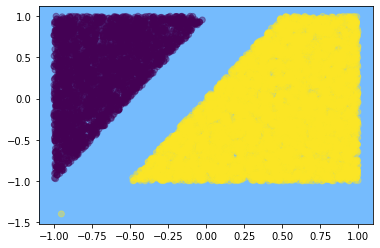

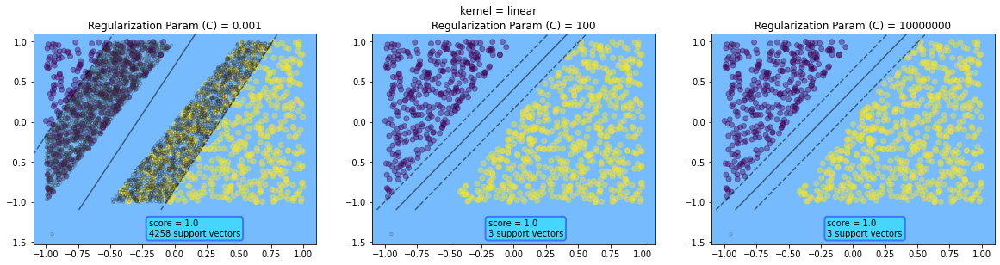

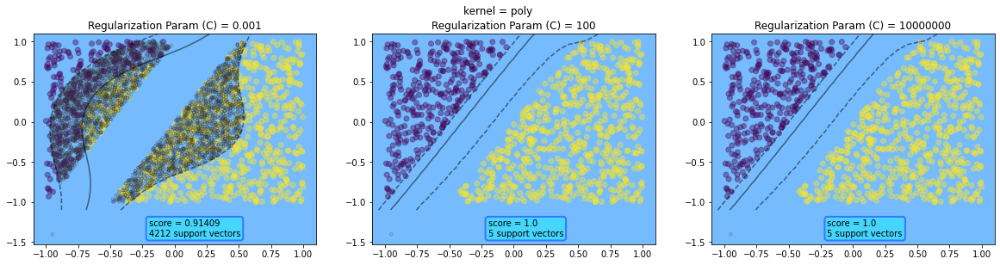

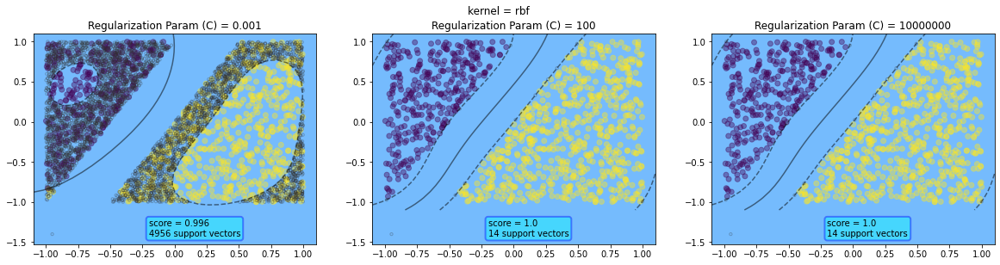

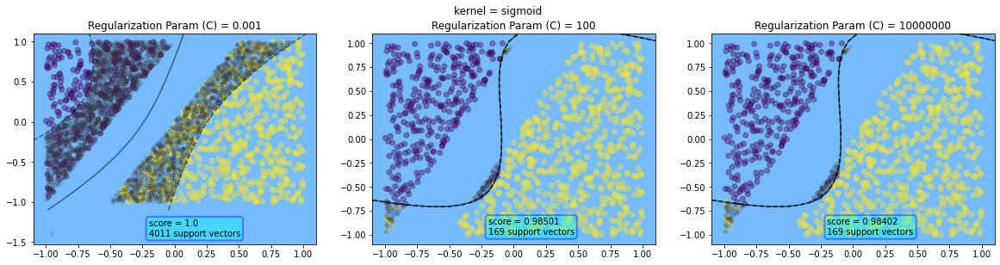

In [3]:
X, y, X_train, X_test, y_train, y_test = get_data("dataset_1.csv")

fig, ax = plt.subplots(nrows=1, ncols=1)
plot_data_set(ax, X, y)

for k in kernels:
    svc_kernel_analysis(X_train, X_test, y_train, y_test, kernel=k)

Clearly the linear kernel is most suitavble for this data-set, aand the Regularization Param (C) does not play a big role when this model is used.
High C will help the polynomial kernel and the Gaussian (rbf), whereas a lower C will make it possible for the sigmoidian kernel ahcieve a perfect score.

https://scikit-learn.org/stable/auto_examples/svm/plot_separating_hyperplane.html#sphx-glr-auto-examples-svm-plot-separating-hyperplane-py

linear

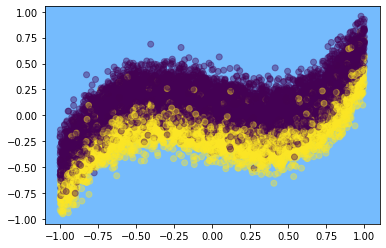

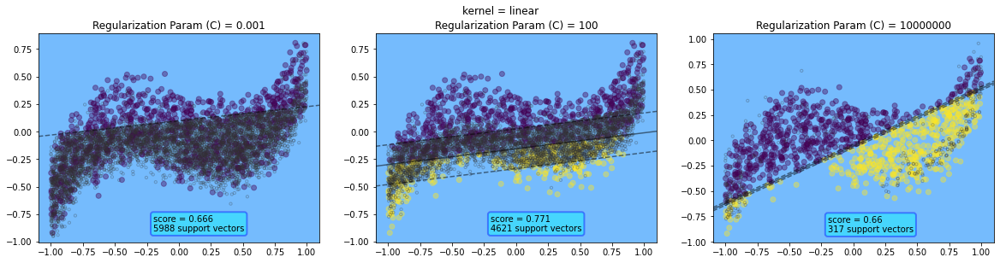

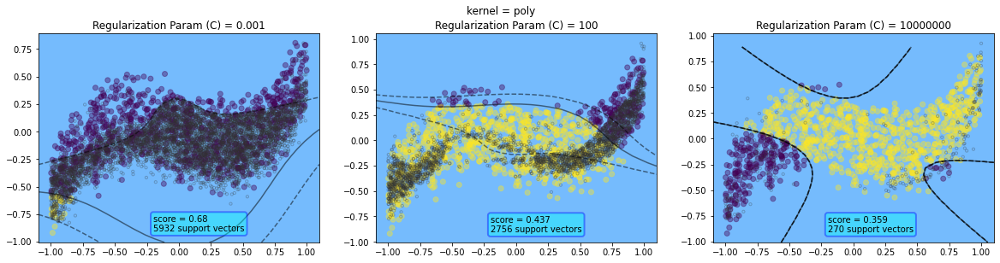

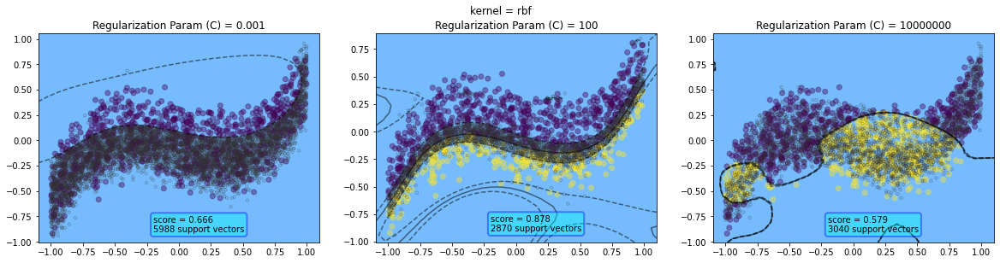

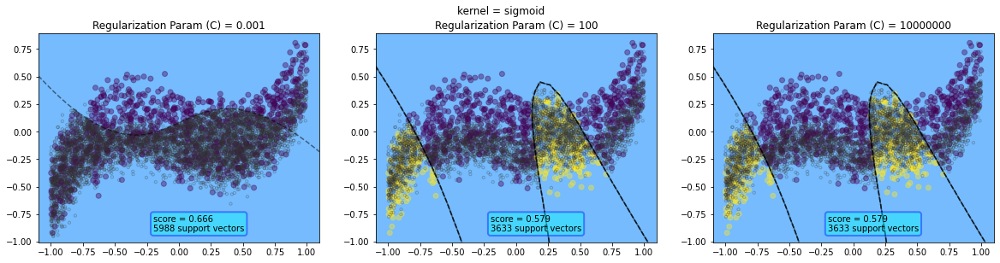

In [4]:
X, y, X_train, X_test, y_train, y_test = get_data("dataset_2.csv")

fig, ax = plt.subplots(nrows=1, ncols=1)
plot_data_set(ax, X, y)

for k in kernels:
    svc_kernel_analysis(X_train, X_test, y_train, y_test, kernel=k)

rbf  kernel (Gaussian) has the best performance here with a C value of roughly 100. I could've zeroed in on a higher score, but I found these values served consistently visually interesting results.
This data set seemed to have a lot of inter-mingling along the border, which capped the high score at roughly 0.87 - 0.88.

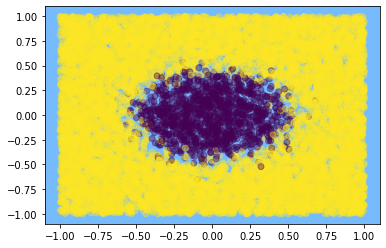

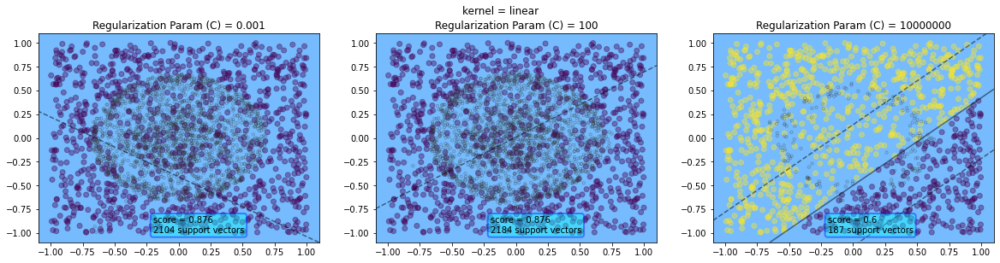

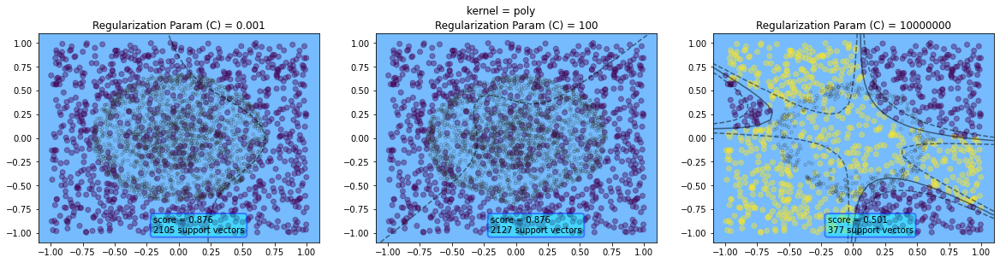

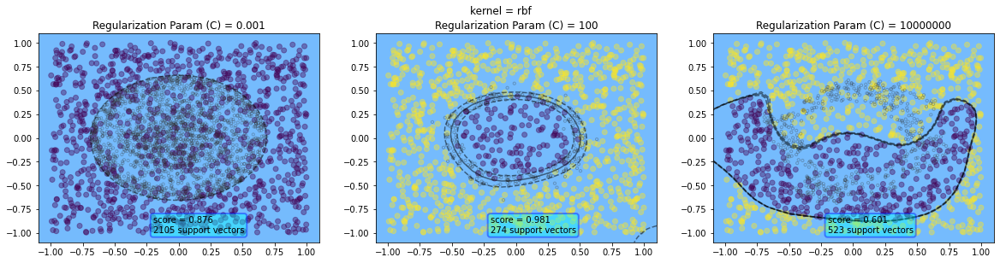

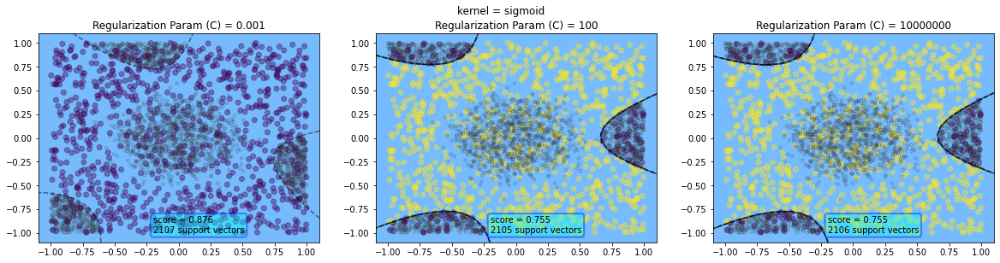

In [5]:
X, y, X_train, X_test, y_train, y_test = get_data("dataset_3.csv")
fig, ax = plt.subplots(nrows=1, ncols=1)
plot_data_set(ax, X, y)

for k in kernels:
    svc_kernel_analysis(X_train, X_test, y_train, y_test, kernel=k)

Again, the Gaussian kernel has the best performance, which makes sense as the yellow classed points have a somewhat gaussian (normal) probability of appearing within a radius of about 0.5 around the center.
The overlap zones are less popluated than in data-set_2, so a high score of aboyt 0.98 -0.99 is achievable more easily.


I'm pretty surprised at how useful these initial functions from [this sklearn example](https://scikit-learn.org/stable/auto_examples/svm/plot_separating_hyperplane.html#sphx-glr-auto-examples-svm-plot-separating-hyperplane-py) made this hand made gridview

Clearly the 